In [1]:
import sys
sys.path.append('/Users/thorsten/code/ThorstenCodes/MorphoMind/')

In [2]:
import pandas as pd
import os
from data_handling.params import LOCAL_DATA_PATH

plate = 24277
Path = f'{LOCAL_DATA_PATH}/{plate}/processed/'
file_path = os.path.join(LOCAL_DATA_PATH, f"{plate}/processed/{plate}_processed.csv")

df = pd.read_csv(file_path)
df.tail()

,Ph-golgi,Hoechst,ERSyto,Mito,ERSytoBleed,CellCount,well,photo_number,Metadata_ASSAY_WELL_ROLE,Drug_id,Metadata_mmoles_per_liter,CPD_NAME,CPD_NAME_TYPE,SOURCE_NAME,CPD_SMILES
2292,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,56.0,p24,2,treated,BRD-K40742111-001-02-6,5.0,baeomycesic acid,common,MicroSource Discovery Systems Inc.,COc1cc(C)c(C(=O)Oc2cc(C)c(O)c(C(O)=O)c2C)c(O)c...
2293,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,121.0,p24,3,treated,BRD-K40742111-001-02-6,5.0,baeomycesic acid,common,MicroSource Discovery Systems Inc.,COc1cc(C)c(C(=O)Oc2cc(C)c(O)c(C(O)=O)c2C)c(O)c...
2294,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,59.0,p24,4,treated,BRD-K40742111-001-02-6,5.0,baeomycesic acid,common,MicroSource Discovery Systems Inc.,COc1cc(C)c(C(=O)Oc2cc(C)c(O)c(C(O)=O)c2C)c(O)c...
2295,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,68.0,p24,5,treated,BRD-K40742111-001-02-6,5.0,baeomycesic acid,common,MicroSource Discovery Systems Inc.,COc1cc(C)c(C(=O)Oc2cc(C)c(O)c(C(O)=O)c2C)c(O)c...
2296,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,/Users/thorsten/.morpho_minds_data/24277/Raw_p...,135.0,p24,6,treated,BRD-K40742111-001-02-6,5.0,baeomycesic acid,common,MicroSource Discovery Systems Inc.,COc1cc(C)c(C(=O)Oc2cc(C)c(O)c(C(O)=O)c2C)c(O)c...


In [9]:
from PIL import Image
import numpy as np
from tensorflow.keras.utils import load_img, img_to_array

# Assuming `df` is your DataFrame and it has columns like 'Ph-golgi', 'Hoechst', etc.

channels = ['Ph-golgi', 'Hoechst', 'ERSyto', 'Mito', 'ERSytoBleed']

# Initialize dictionaries to hold file paths and preprocessed images
channel_image_files = {channel: [] for channel in channels}
channel_images = {channel: [] for channel in channels}

# Iterate through each channel
for channel in channels:
    paths = df[channel].tolist()

    # Iterate through each path, load, and preprocess the image
    for path in paths:
        # Append file path
        channel_image_files[channel].append(path)

        # Load, resize, and convert image to array
        img = load_img(path, target_size=(224, 224), color_mode='grayscale')
        img_array = img_to_array(img)
        img_array_expanded = np.expand_dims(img_array, axis=0)
        # Convert the grayscale image to RGB by duplicating the single channel three times
        img_array_rgb = np.repeat(img_array_expanded, 3, axis=-1)

        # Append the preprocessed RGB image
        channel_images[channel].append(img_array_rgb)


print({channel: len(channel_image_files[channel]) for channel in channel_image_files})
print({channel: len(channel_images[channel]) for channel in channel_images})

{'Ph-golgi': 2297, 'Hoechst': 2297, 'ERSyto': 2297, 'Mito': 2297, 'ERSytoBleed': 2297}
{'Ph-golgi': 2297, 'Hoechst': 2297, 'ERSyto': 2297, 'Mito': 2297, 'ERSytoBleed': 2297}


In [8]:
# print(channel_images['Ph-golgi'][0].shape)
# img_array_rgb = np.repeat(img_array_expanded, 3, axis=-1)
# print(img_array_rgb.shape)
# img_array_rgb

(1, 224, 224, 1)
(1, 224, 224, 3)


array([[[[420., 420., 420.],
         [407., 407., 407.],
         [413., 413., 413.],
         ...,
         [613., 613., 613.],
         [595., 595., 595.],
         [621., 621., 621.]],

        [[433., 433., 433.],
         [415., 415., 415.],
         [401., 401., 401.],
         ...,
         [584., 584., 584.],
         [583., 583., 583.],
         [597., 597., 597.]],

        [[427., 427., 427.],
         [419., 419., 419.],
         [397., 397., 397.],
         ...,
         [506., 506., 506.],
         [565., 565., 565.],
         [568., 568., 568.]],

        ...,

        [[447., 447., 447.],
         [464., 464., 464.],
         [521., 521., 521.],
         ...,
         [869., 869., 869.],
         [860., 860., 860.],
         [783., 783., 783.]],

        [[452., 452., 452.],
         [483., 483., 483.],
         [500., 500., 500.],
         ...,
         [841., 841., 841.],
         [869., 869., 869.],
         [777., 777., 777.]],

        [[455., 455., 455.],
       

In [13]:
channel_images['Ph-golgi'][0].shape

(1, 224, 224, 3)

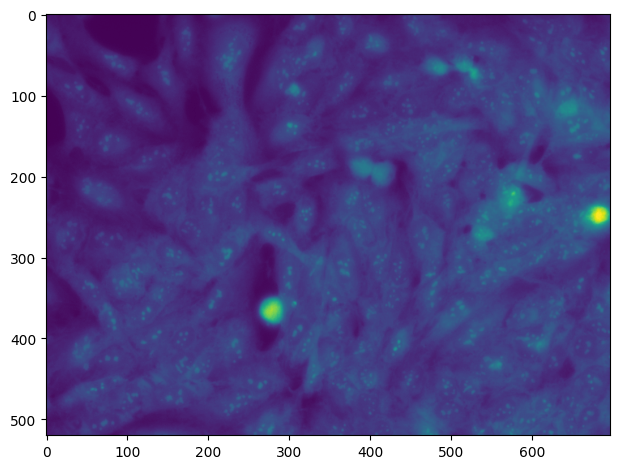

In [75]:
import matplotlib.pyplot as plt

img_path = path  # Assuming ‘image_files’ contains paths of images in the same order as ‘features’
img = Image.open(img_path)
plt.imshow(np.asarray(img))
plt.tight_layout()
plt.show()

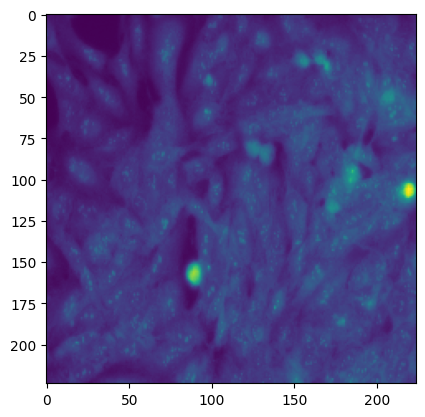

In [77]:
img = load_img(path, target_size=(224, 224),color_mode='grayscale')
plt.imshow(img)

In [29]:
# import os
# import numpy as np
# from tensorflow.keras.preprocessing.image import load_img, img_to_array

# base_dir = '/Users/thorsten/code/ThorstenCodes/MorphoMind/raw_data'
# plate = '24277'
# channels = ['Hoechst', 'Ph_golgi', 'ERSytoBleed', 'ERSyto', 'Mito']

# # Initialize dictionaries to hold images and file paths, organized by channel
# channel_images = {}
# channel_image_files = {}

# # Loop through each channel and process images
# for channel in channels:
#     channel_dir = os.path.join(base_dir, f"plate_{plate}", f"{plate}-{channel}")
#     if os.path.isdir(channel_dir):
#         # Initialize the list for this channel in the dictionaries
#         channel_image_files[channel] = []
#         channel_images[channel] = []

#         files = [os.path.join(channel_dir, f) for f in os.listdir(channel_dir) if f.lower().endswith('.tif')]
#         channel_image_files[channel].extend(files)  # Append new files to the list for this channel
#         for img_path in files:
#             img = load_img(img_path, target_size=(224, 224))  # Load and resize image
#             img_array = img_to_array(img)  # Convert image to array
#             channel_images[channel].append(img_array)  # Append image array to list for this channel
#     else:
#         print(f"Directory {channel_dir} not found.")

# # Optionally, convert lists in the channel_images dictionary to numpy arrays for easier handling with models
# for channel in channel_images:
#     channel_images[channel] = np.array(channel_images[channel])

# # Example usage
# print(f"Number of files in Hoechst channel: {len(channel_image_files['Hoechst'])}")
# print(f"Shape of images in Hoechst channel: {channel_images['Hoechst'].shape}")
# print(f"Number of files in Ph_golgi channel: {len(channel_image_files['Ph_golgi'])}")
# print(f"Shape of images in Ph_golgi channel: {channel_images['Ph_golgi'].shape}")
# print(f"Number of files in ERSytoBleed channel: {len(channel_image_files['ERSytoBleed'])}")
# print(f"Shape of images in ERSytoBleed channel: {channel_images['ERSytoBleed'].shape}")
# print(f"Number of files in ERSyto channel: {len(channel_image_files['ERSyto'])}")
# print(f"Shape of images in ERSyto channel: {channel_images['ERSyto'].shape}")
# print(f"Number of files in Mito channel: {len(channel_image_files['Mito'])}")
# print(f"Shape of images in Mito channel: {channel_images['Mito'].shape}")

Number of files in Hoechst channel: 2304
Shape of images in Hoechst channel: (2304, 224, 224, 3)
Number of files in Ph_golgi channel: 2304
Shape of images in Ph_golgi channel: (2304, 224, 224, 3)
Number of files in ERSytoBleed channel: 2304
Shape of images in ERSytoBleed channel: (2304, 224, 224, 3)
Number of files in ERSyto channel: 2304
Shape of images in ERSyto channel: (2304, 224, 224, 3)
Number of files in Mito channel: 2304
Shape of images in Mito channel: (2304, 224, 224, 3)


In [24]:
channel_images['Ph-golgi'][0].shape

(1, 224, 224, 3)

In [14]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

def build_feature_extractor(img_width=224, img_height=224, pretrained_model='MobileNetV2'):
    ''' This functions loads the top-layer of the model and extracts its preprocessing and applies it to the images'''
    # Correctly initialize models and preprocessing functions
    models = {'MobileNetV2': tf.keras.applications.MobileNetV2(weights="imagenet", include_top=False, pooling="avg", input_shape=(img_height, img_width, 3))}
    preprocess = {'MobileNetV2': keras.applications.mobilenet_v2.preprocess_input}

    feature_extractor = models[pretrained_model]
    preprocess_input = preprocess[pretrained_model]

    inputs = keras.Input((img_height, img_width, 3))
    preprocessed = preprocess_input(inputs)
    outputs = feature_extractor(preprocessed)

    return keras.Model(inputs, outputs, name="feature_extractor")

In [18]:
np.expand_dims(channel_images[channel][0], axis=0).shape

(1, 224, 224, 3)

In [19]:
# Instantiate the feature extractor model
channel_feat = {}
feature_extractor_model = build_feature_extractor()
# for channel in channels:
#     for i in range(len(channel_images[channel])):
#         features = feature_extractor_model.predict(channel_images[channel][i])
#         channel_feat[channel] = features
# channel_feat

for channel in channels:
    # Prepare the images in a single batch for the channel
    images_batch = np.vstack(channel_images[channel])
    # Preprocess the images batch
    images_batch_preprocessed = preprocess_input(images_batch)
    # Extract features in a single call
    features = feature_extractor_model.predict(images_batch_preprocessed)
    channel_feat[channel] = features

channel_feat

72/72 [==============================] - 14s 195ms/step


{'Ph-golgi': array([[0.98431724, 0.        , 0.593344  , ..., 0.        , 0.02866475,
         1.0915935 ],
        [1.0651683 , 0.        , 0.22089471, ..., 0.        , 0.0181651 ,
         0.535045  ],
        [0.86441416, 0.        , 0.40099895, ..., 0.        , 0.        ,
         0.18434551],
        ...,
        [0.42674622, 0.        , 0.13461387, ..., 0.        , 0.04275125,
         0.9797936 ],
        [0.8290353 , 0.01223873, 0.01889722, ..., 0.        , 0.00754863,
         0.3005947 ],
        [0.05682898, 0.        , 0.49025038, ..., 0.        , 0.        ,
         1.4326854 ]], dtype=float32),
 'Hoechst': array([[0.55396354, 0.24099883, 0.01280579, ..., 0.        , 0.32464957,
         1.3887461 ],
        [0.5412682 , 0.41448367, 0.        , ..., 0.        , 0.26886135,
         1.1680019 ],
        [0.45250648, 0.10066887, 0.00760197, ..., 0.        , 0.08422983,
         0.49195278],
        ...,
        [1.8586687 , 0.07819615, 0.00229133, ..., 0.        , 0.180509

In [20]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

##################################
###### PCA ######################
#################################
pca_channels = {}
clusters = {}
for channel in channels:
# Number of components for PCA
    n_components = 2

    # Initialize and fit PCA
    pca = PCA(n_components=n_components)
    pca_channels[channel] = pca.fit_transform(channel_feat[channel])

#################################
### Clustering using Kmeans #####
#################################

# Number of clusters
    n_clusters = 5

    # Initialize KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)

    # Fit KMeans on the features
    clusters[channel] = kmeans.fit_predict(pca_channels[channel])


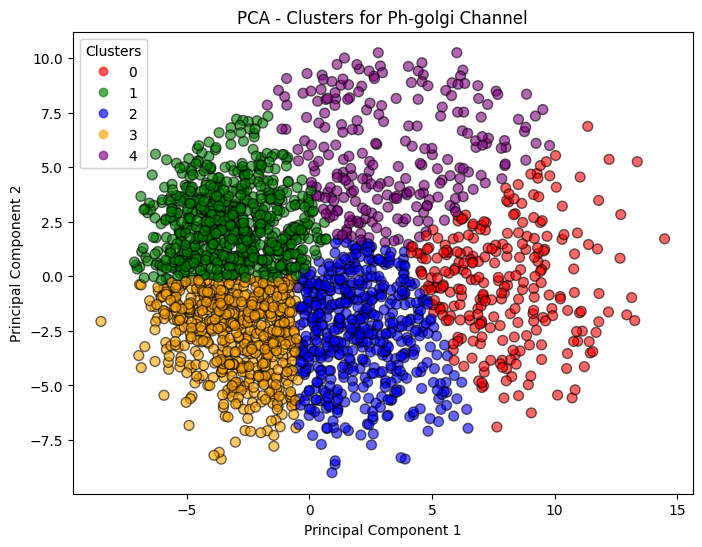

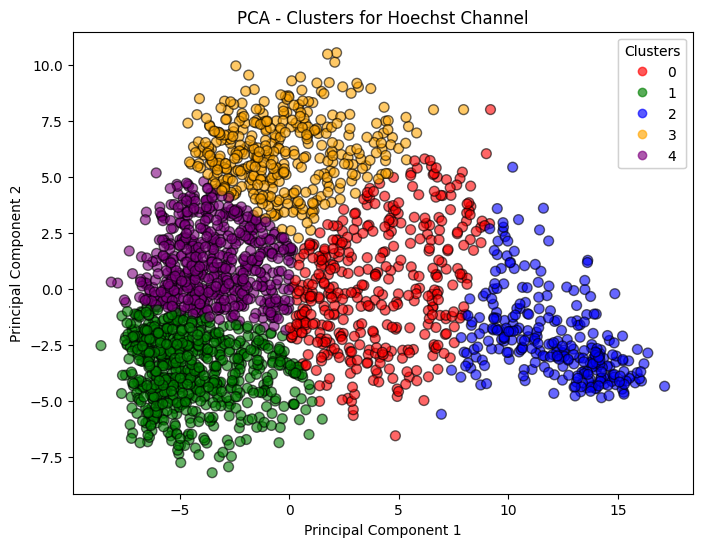

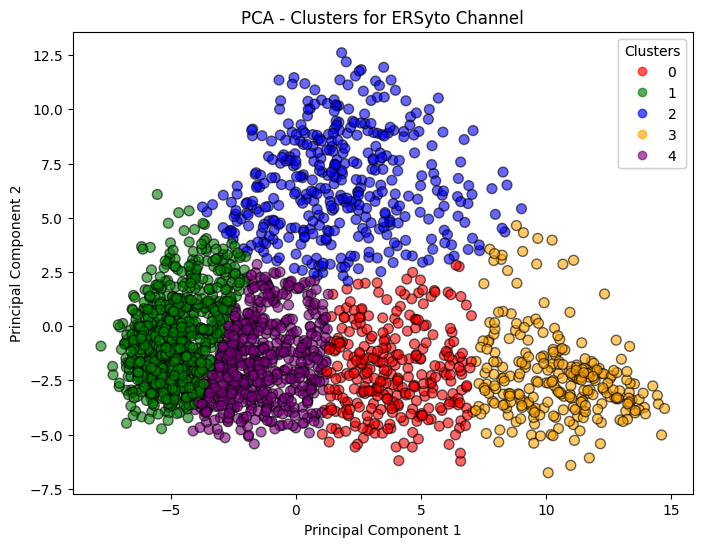

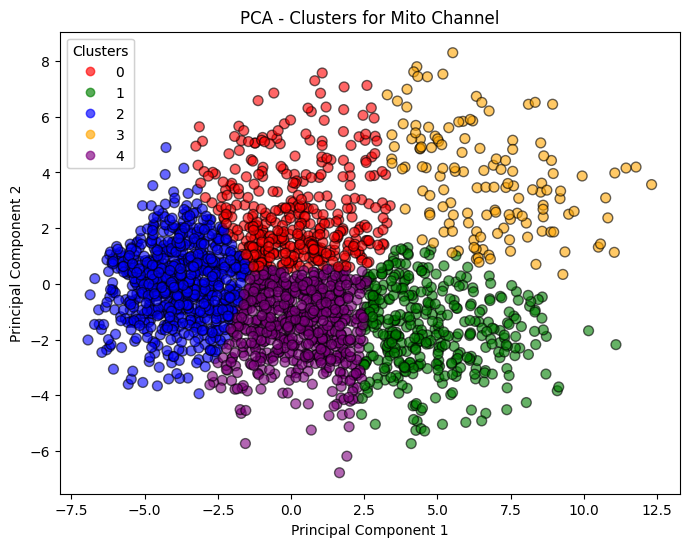

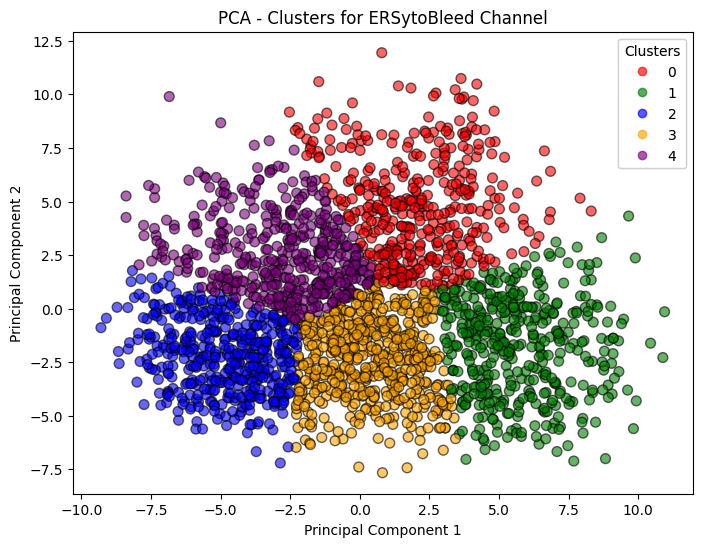

In [21]:
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt

# Define a list of discrete colors
colors = ['red', 'green', 'blue', 'orange', 'purple']
# Create a ListedColormap object with the specified colors
cmap = ListedColormap(colors[:n_clusters])

# Iterate over each channel to plot
for channel in channels:
    # Get the PCA components and clusters
    pca_components = pca_channels[channel]
    cluster_assignments = clusters[channel]

    # Plot the first two PCA components
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(pca_components[:, 0], pca_components[:, 1], c=cluster_assignments, cmap=cmap, marker='o', edgecolor='k', s=50, alpha=0.6)
    plt.title(f'PCA - Clusters for {channel} Channel')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')

    # Create a legend for the clusters
    legend1 = plt.legend(*scatter.legend_elements(), loc="best", title="Clusters")
    plt.gca().add_artist(legend1)

    # Show the plot
    plt.show()


Channel: Ph-golgi


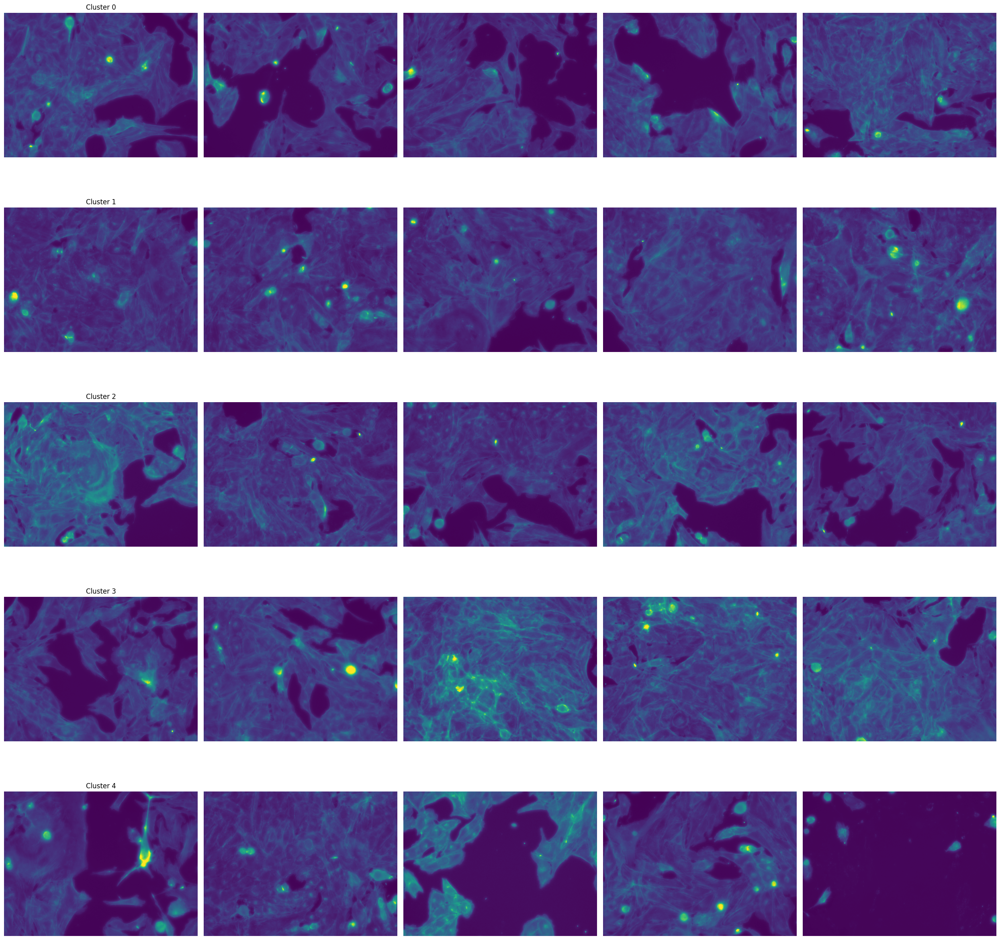

Channel: Hoechst


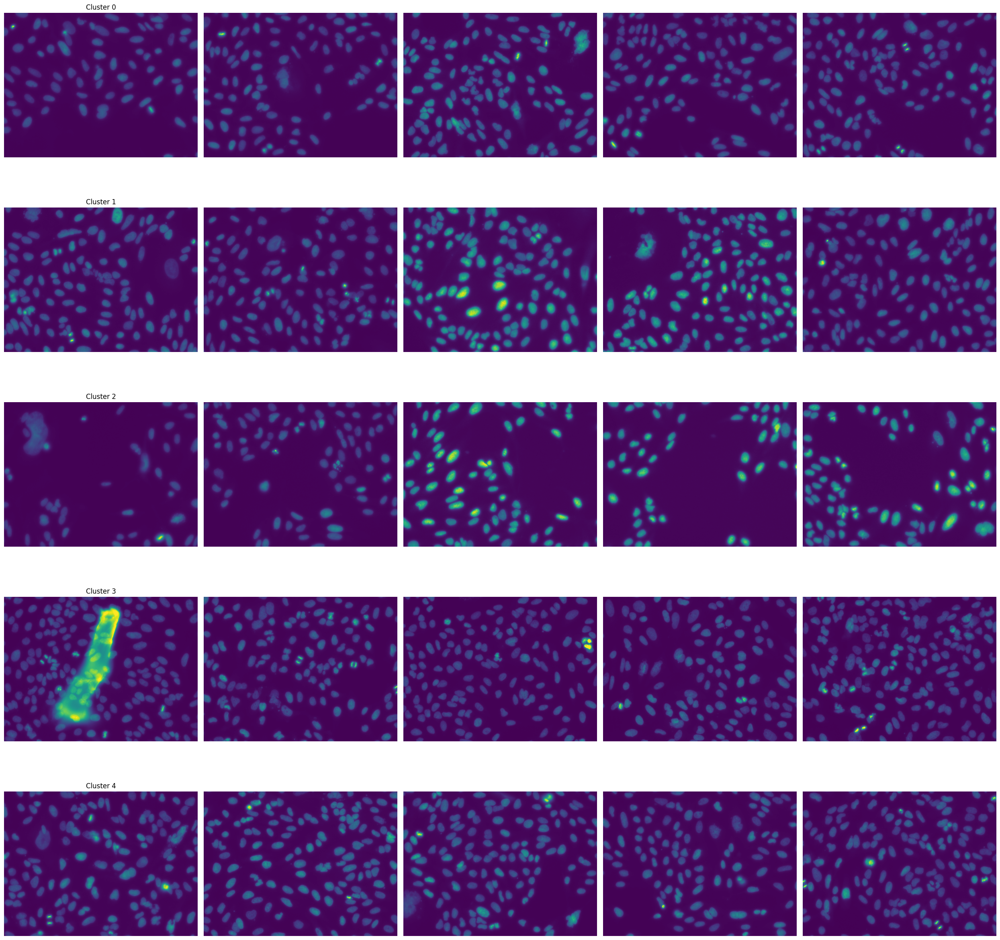

Channel: ERSyto


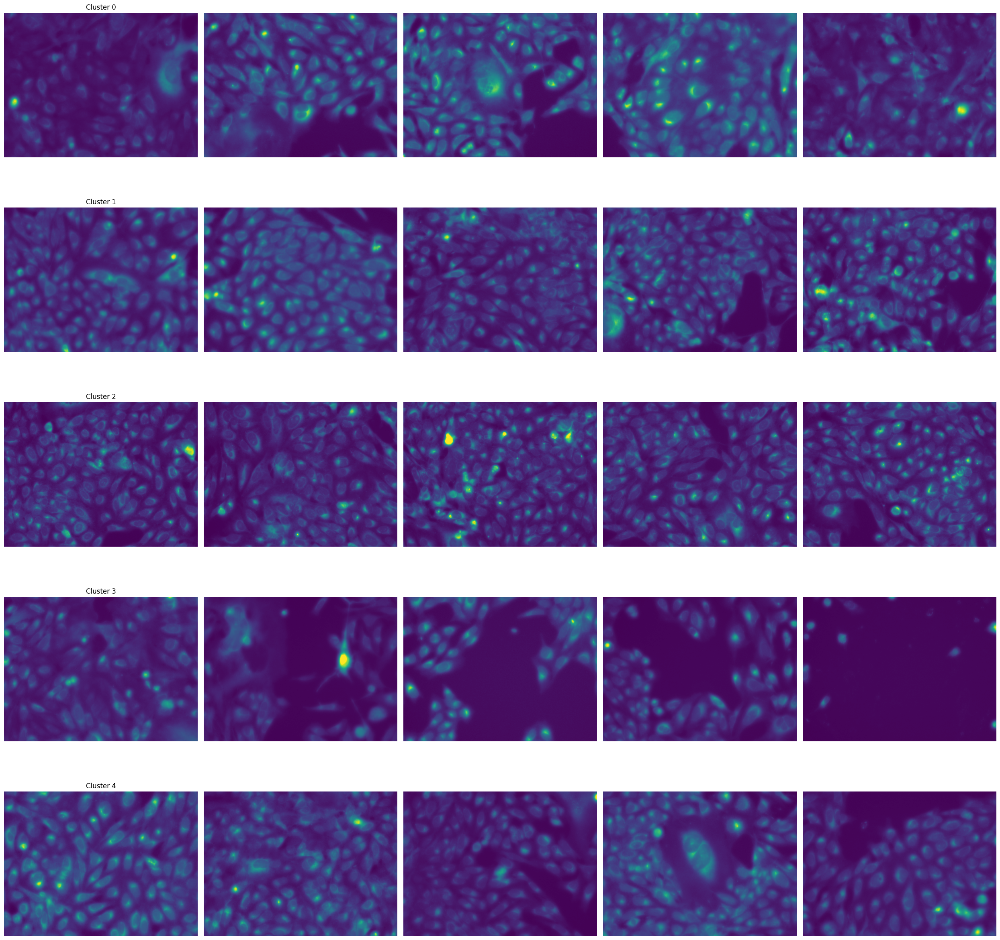

Channel: Mito


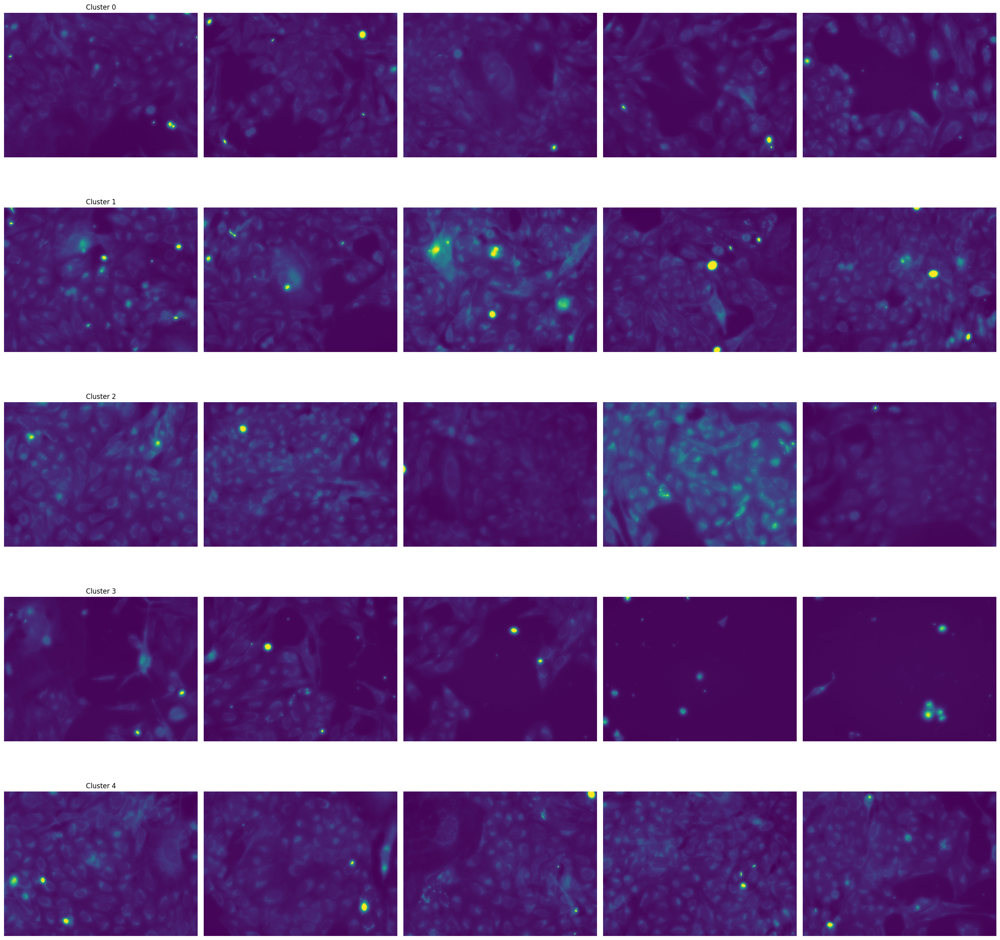

Channel: ERSytoBleed


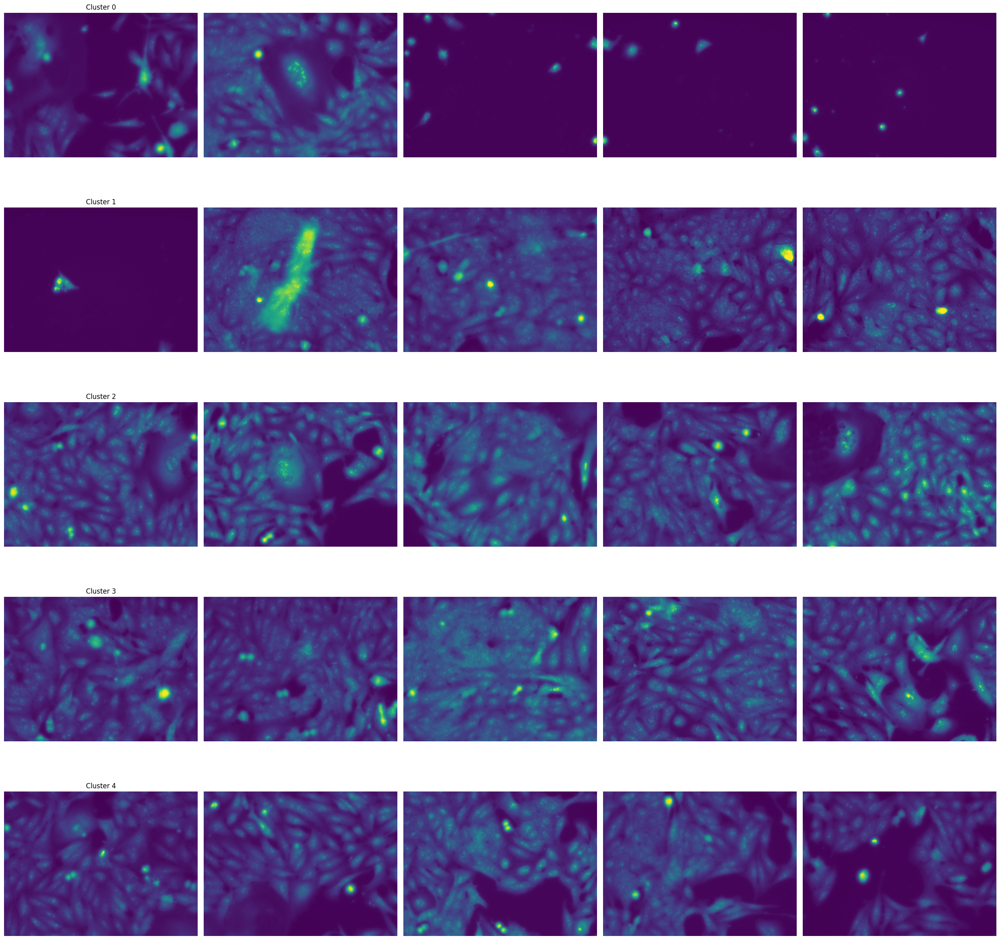

In [22]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

images_per_cluster = 5
n_clusters = 5

# Iterate over each channel
for channel in channels:
    print(f"Channel: {channel}")
    # Create subplots - rows are clusters, columns are images
    fig, axs = plt.subplots(n_clusters, images_per_cluster, figsize=(5 * images_per_cluster, 5 * n_clusters))

    # Ensure axs is a 2D array
    if n_clusters == 1:
        axs = np.array([axs])
    if images_per_cluster == 1:
        axs = np.expand_dims(axs, axis=-1)

    for i in range(n_clusters):
        # Get indices of images in this cluster
        indices = np.where(clusters[channel] == i)[0]
        # Select a subset of images from the cluster
        selected_indices = indices[:images_per_cluster]  # Take the first 'n' images for simplicity

        for j, idx in enumerate(selected_indices):
            # Load and display the image
            img_path = channel_image_files[channel][idx]  # Accessing path using channel key and index
            img = Image.open(img_path)
            ax = axs[i, j]
            ax.imshow(np.asarray(img))
            ax.axis('off')  # Hide the axis
            if j == 0:
                ax.set_title(f'Cluster {i}')
    # Adjust layout
    plt.tight_layout()
    plt.show()
